# Bosch Dataset Traffic Light Frozen Inference Model Tests

### Bosch model Tests

Tests of traffic light detection/localization/classification. 

# Imports

In [9]:
import numpy as np
import os
import sys
import tensorflow as tf

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

import time

# Tested with tensorflow 1.3


In [10]:
# This is needed to display the images withing the notbook.
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [11]:
from utils import label_map_util

from utils import visualization_utils as vis_util

## Helper code

In [12]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `1`, we know that this corresponds to `Green`, 2 to `Red`, and 3 to `Yellow`.

In [13]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'bosch_label_map.pbtxt'

NUM_CLASSES = 14

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Model preparation for b_t1_rfcn_resnet_4167_frozen_inference_graph

In [36]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'bosch', 'b_t1_rfcn_resnet_4167_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [37]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## b_t1_rfcn_resnet_4167_frozen_inference_graph
## Detection on Bosch Test Images

In [38]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_bosch'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.png'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

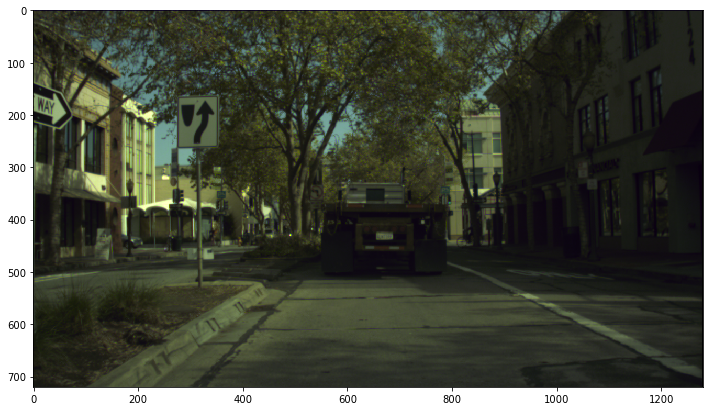

Time in ms:  3681.800127029419 



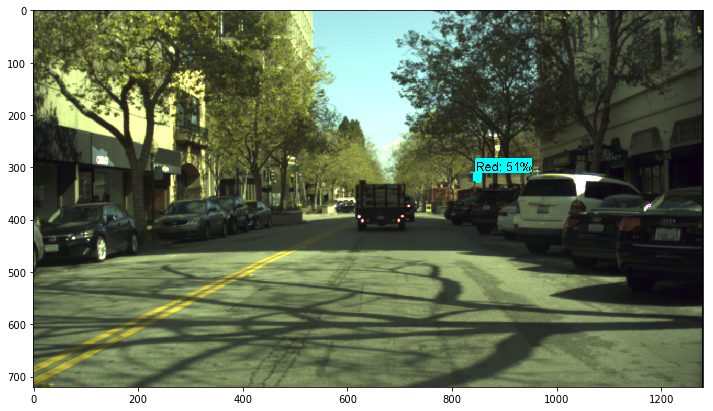

Time in ms:  157.92298316955566 



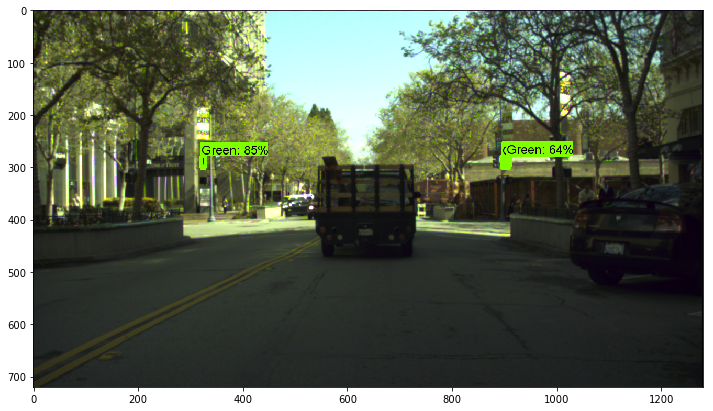

Time in ms:  157.8361988067627 



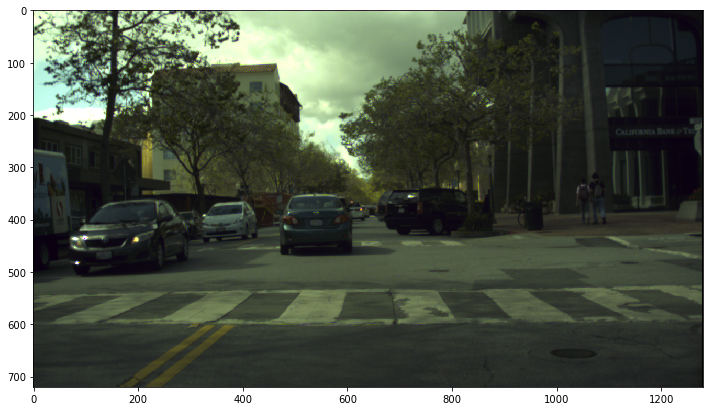

Time in ms:  152.909517288208 



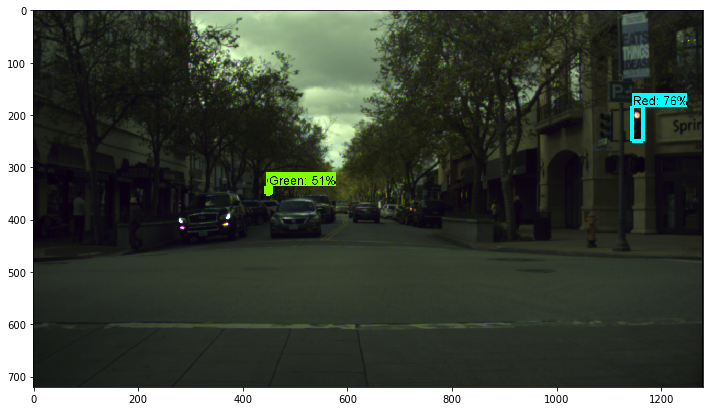

Time in ms:  155.41553497314453 



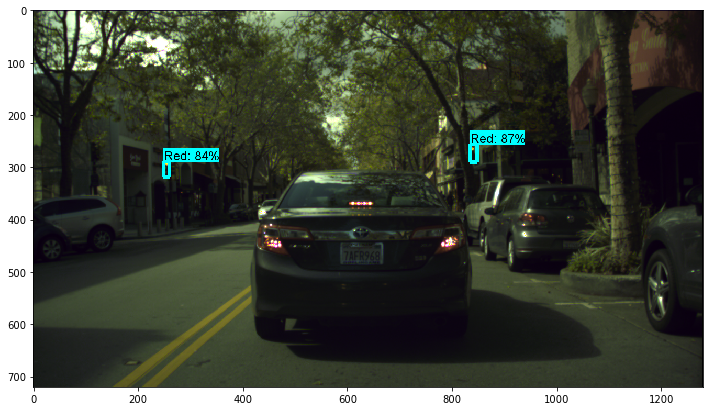

Time in ms:  165.94386100769043 



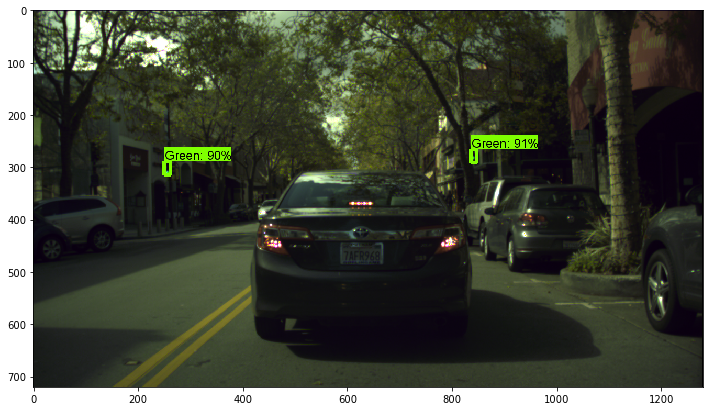

Time in ms:  157.42158889770508 



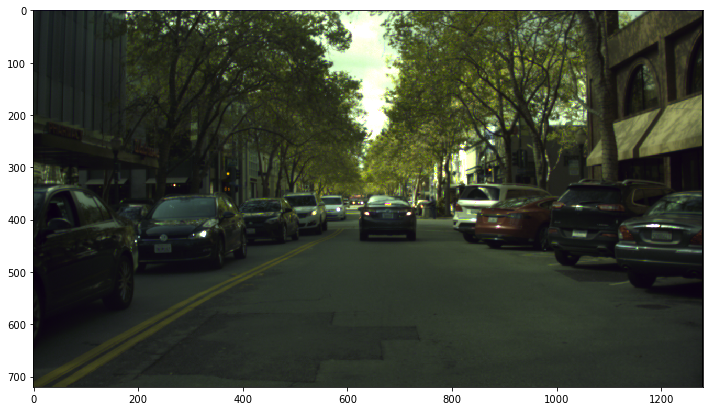

Time in ms:  155.9145450592041 



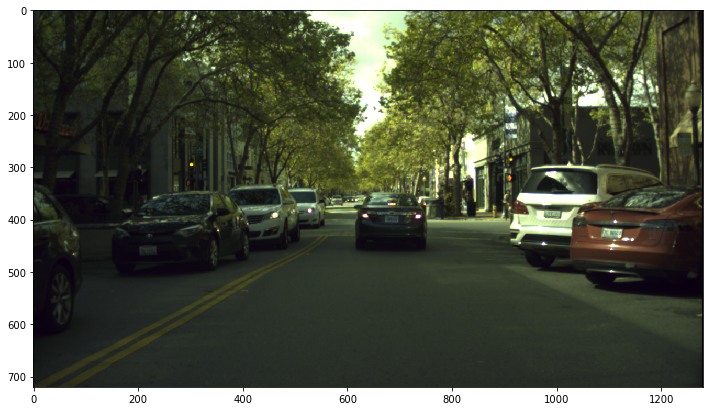

Time in ms:  159.9280834197998 



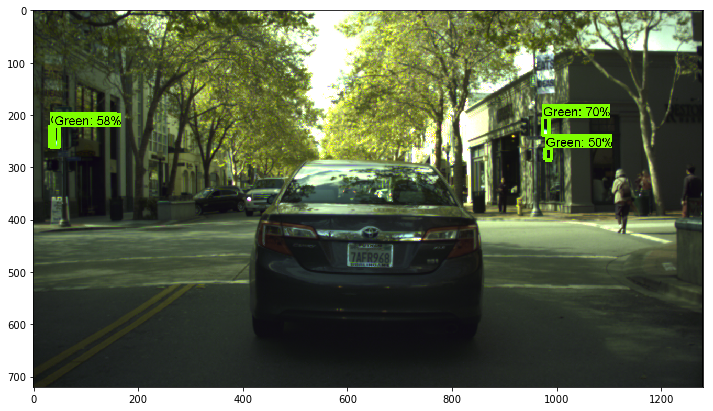

Time in ms:  156.91709518432617 



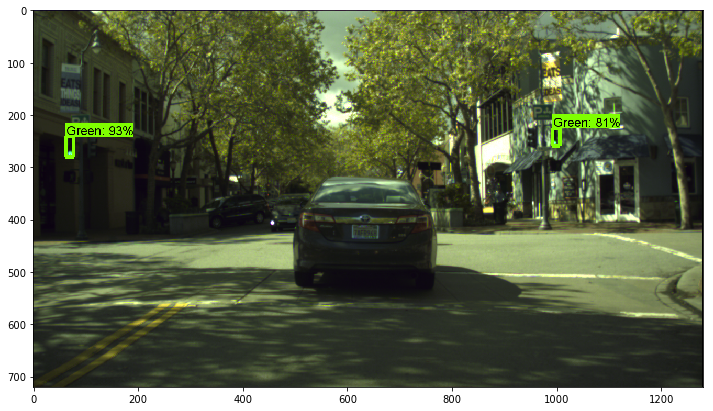

Time in ms:  155.41744232177734 



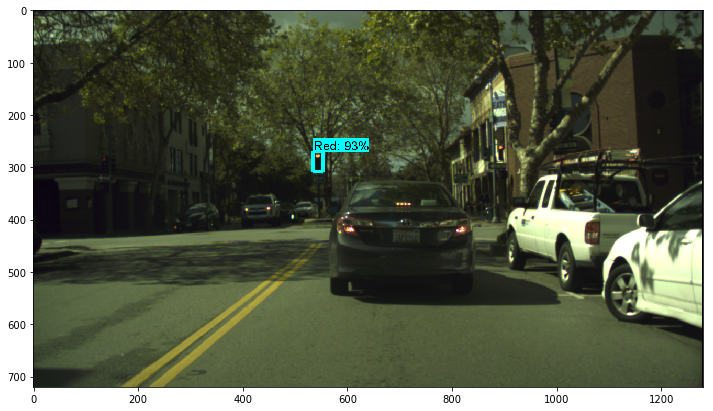

Time in ms:  157.42111206054688 



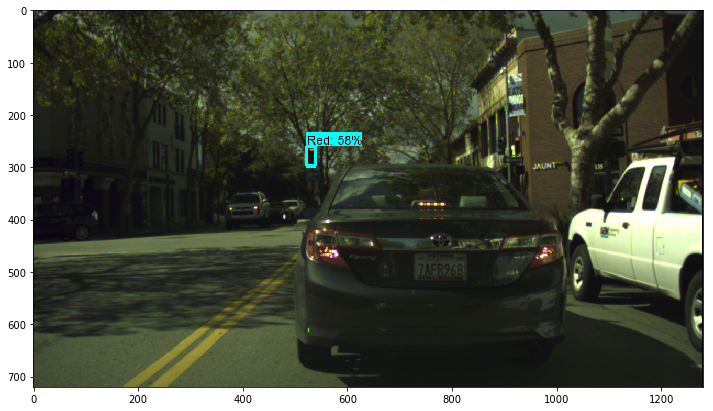

Time in ms:  156.419038772583 



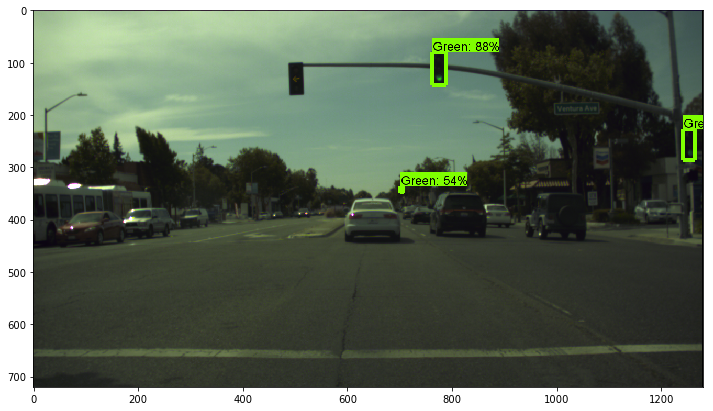

Time in ms:  156.91733360290527 



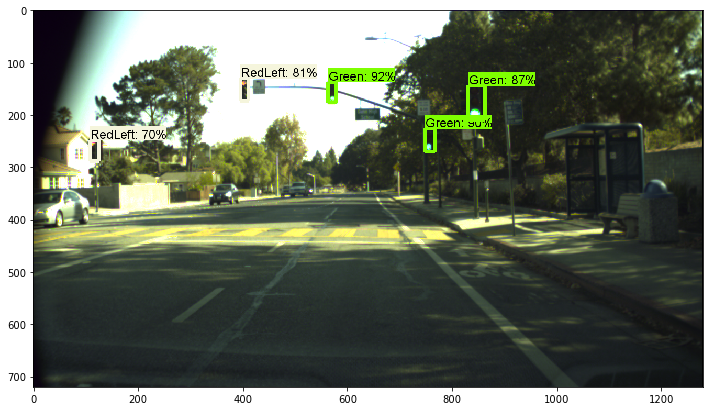

Time in ms:  159.92498397827148 



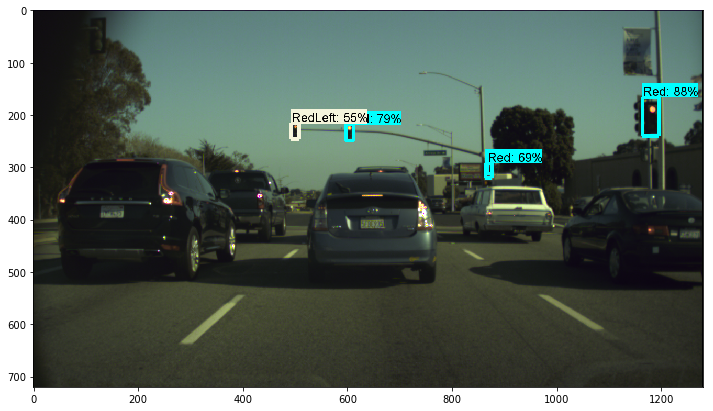

Time in ms:  161.43226623535156 



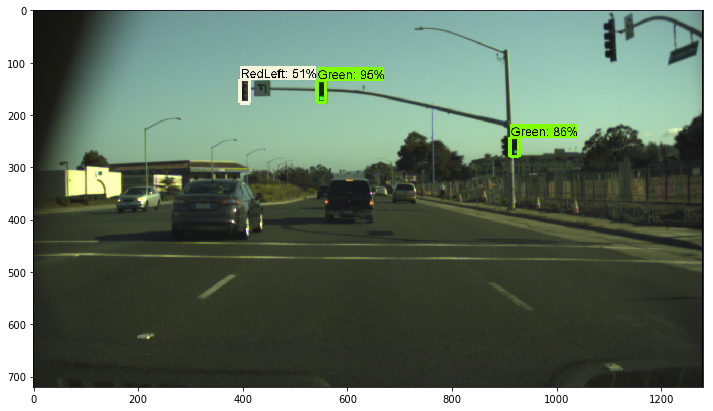

Time in ms:  158.92529487609863 



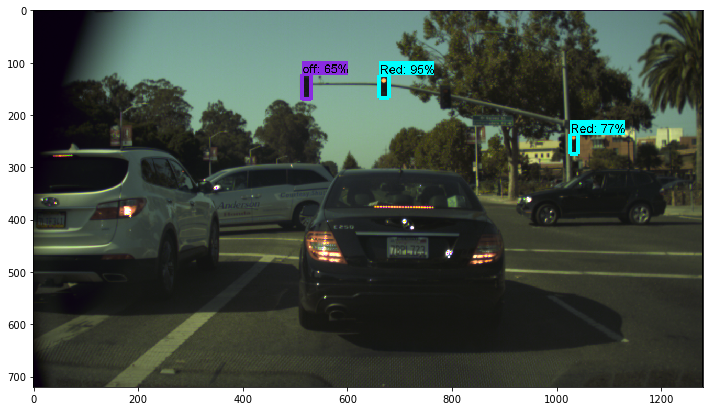

Time in ms:  155.91716766357422 



In [39]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for b_t3_fast_rcnn_resnet_7438_frozen_inference_graph

In [48]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'bosch', 'b_t3_fast_rcnn_resnet_7438_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [49]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## b_t3_fast_rcnn_resnet_7438_frozen_inference_graph
## Detection on Real Images from Test Track

In [50]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_bosch'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.png'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

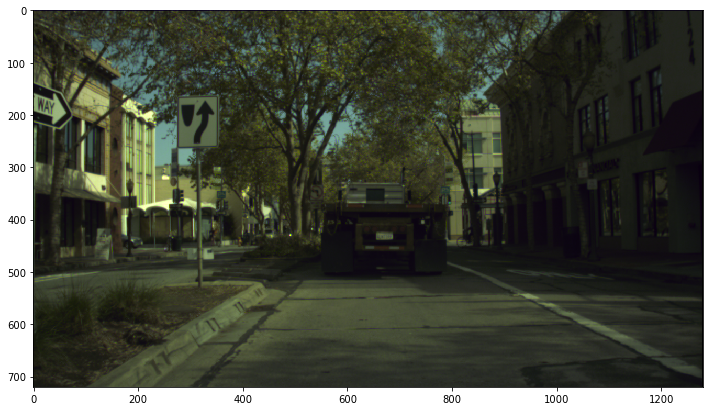

Time in ms:  3396.5399265289307 



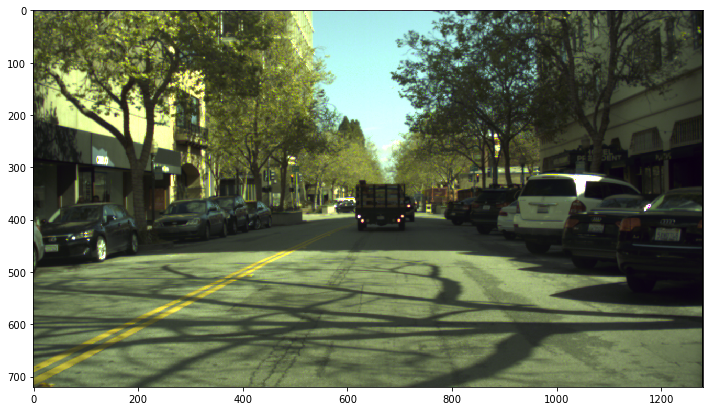

Time in ms:  119.82154846191406 



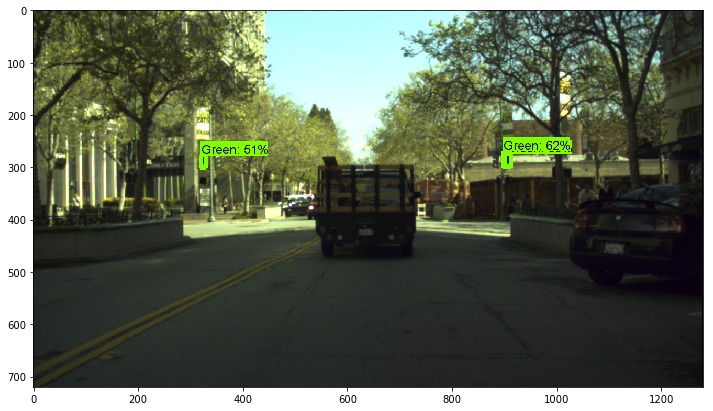

Time in ms:  121.32501602172852 



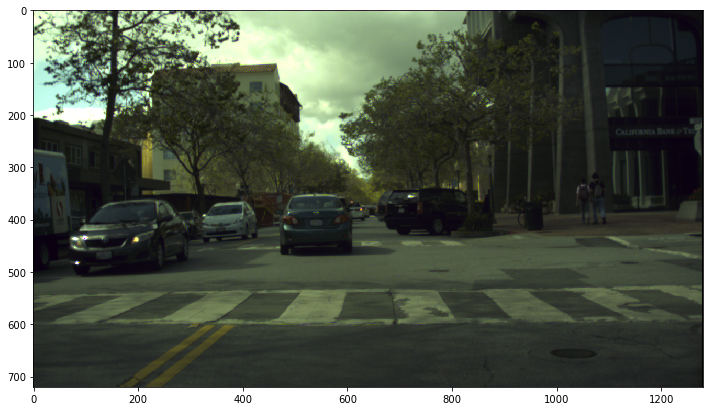

Time in ms:  123.33178520202637 



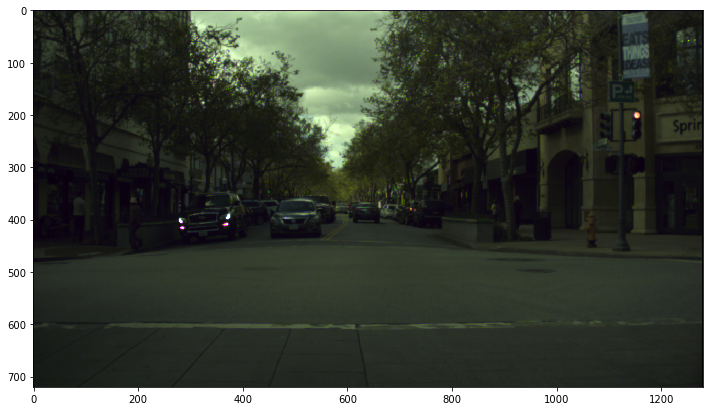

Time in ms:  120.82457542419434 



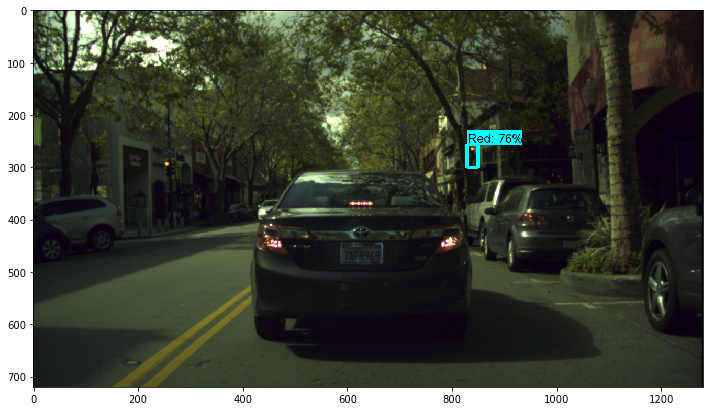

Time in ms:  124.33385848999023 



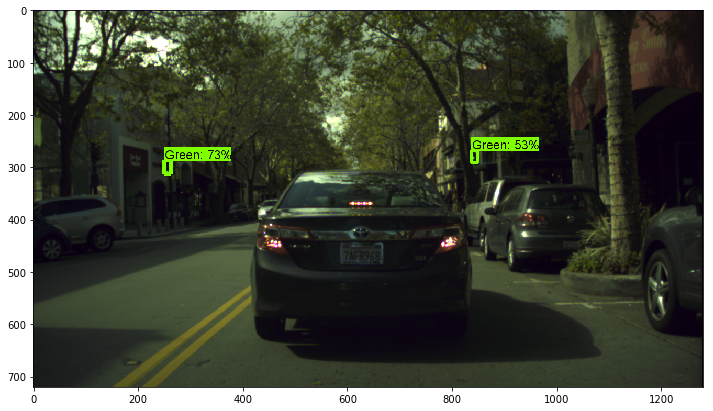

Time in ms:  122.32637405395508 



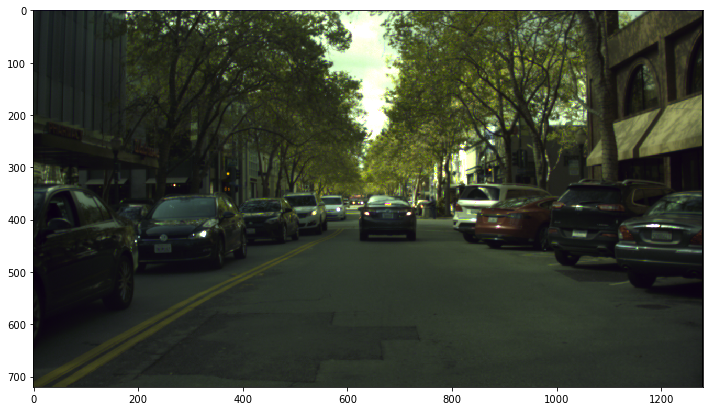

Time in ms:  120.32294273376465 



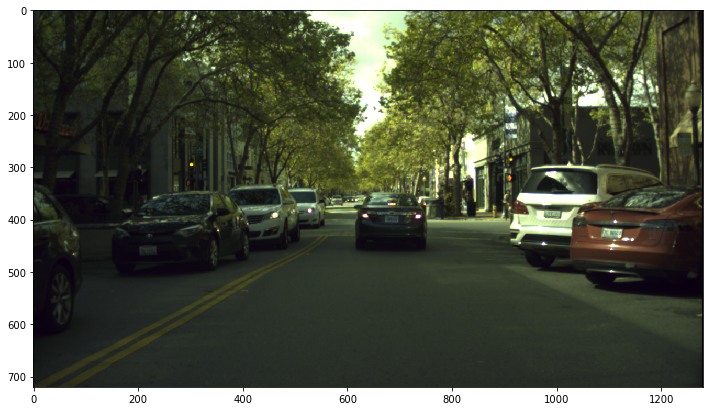

Time in ms:  124.33433532714844 



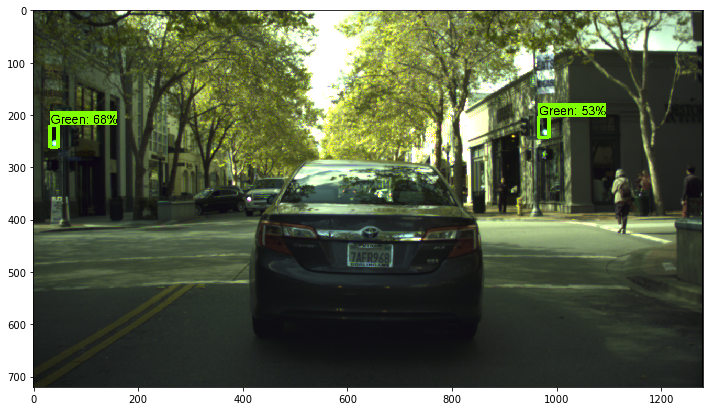

Time in ms:  125.33712387084961 



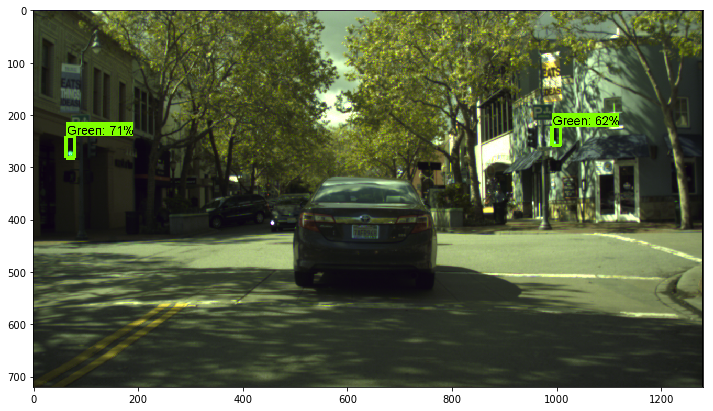

Time in ms:  119.82107162475586 



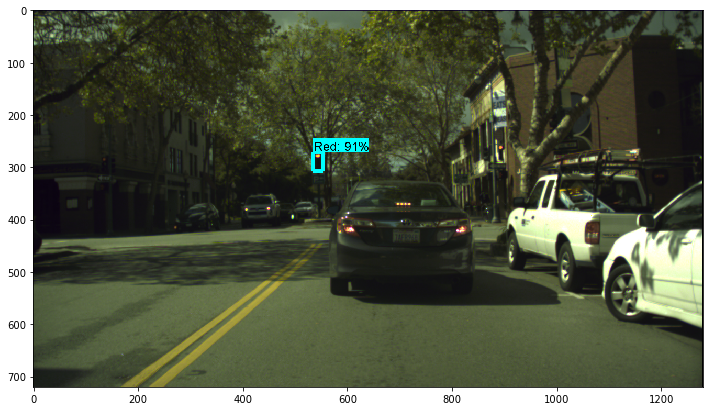

Time in ms:  120.82433700561523 



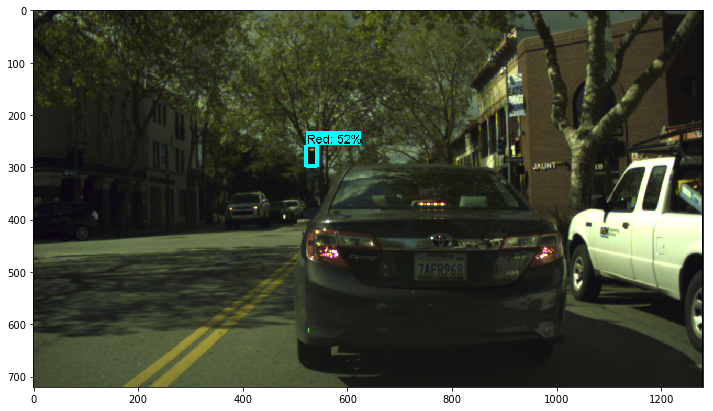

Time in ms:  120.32270431518555 



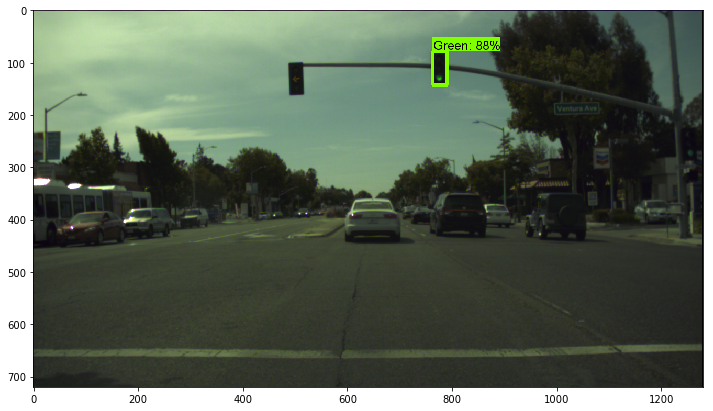

Time in ms:  119.82178688049316 



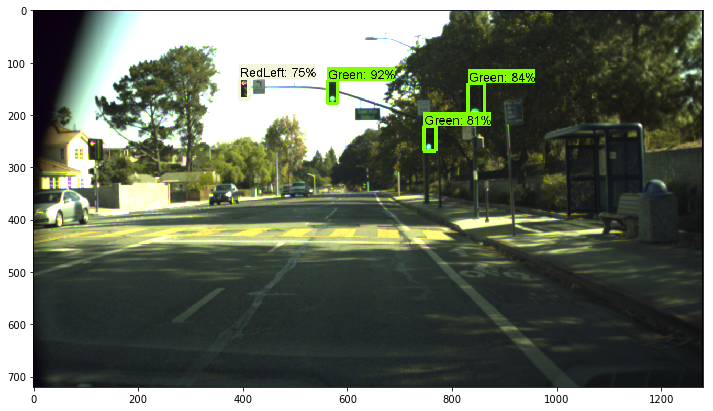

Time in ms:  119.31991577148438 



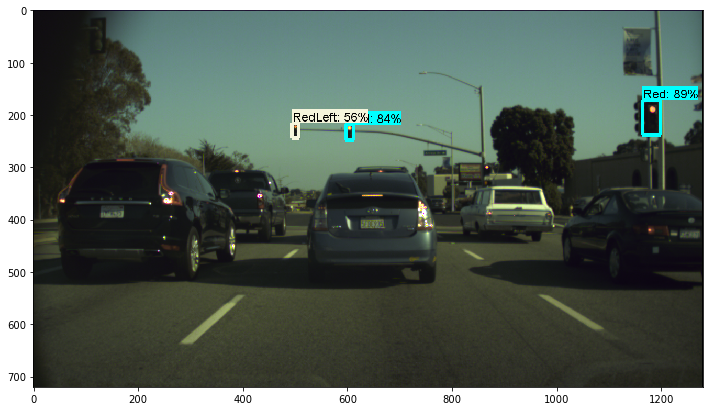

Time in ms:  124.33505058288574 



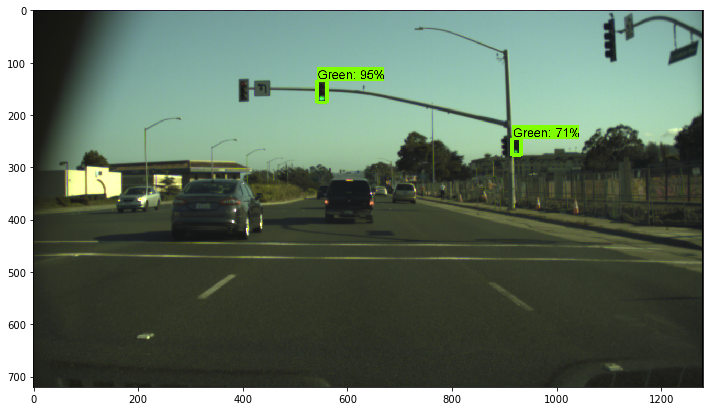

Time in ms:  125.83780288696289 



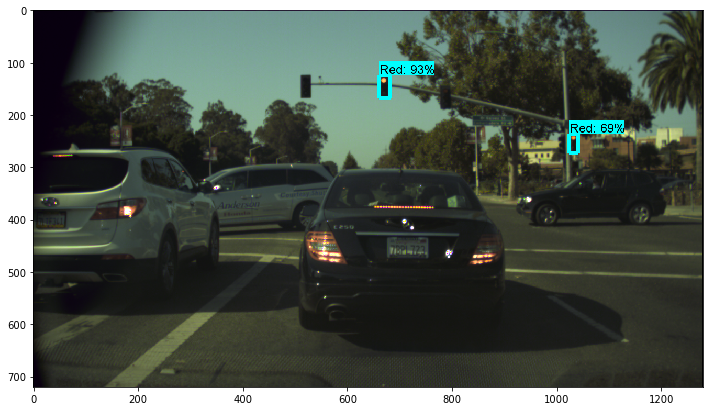

Time in ms:  127.34580039978027 



In [51]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for b_t3_fast_rcnn_resnet_11172_frozen_inference_graph

In [32]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'bosch', 'b_t3_fast_rcnn_resnet_11172_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [33]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## b_t3_fast_rcnn_resnet_11172_frozen_inference_graph
## Detection on Real Images from Test Track

In [34]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_bosch'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.png'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

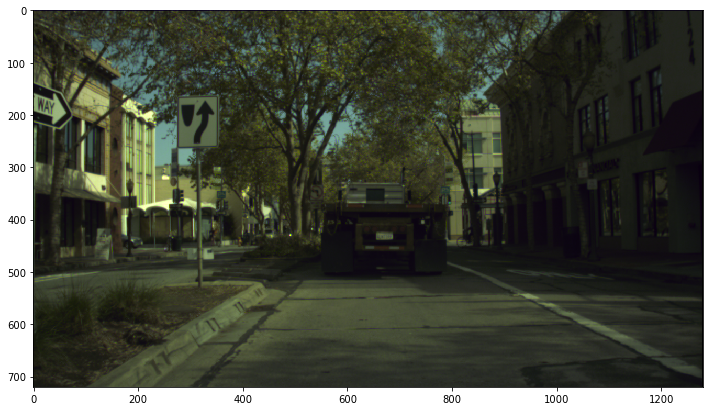

Time in ms:  3516.8612003326416 



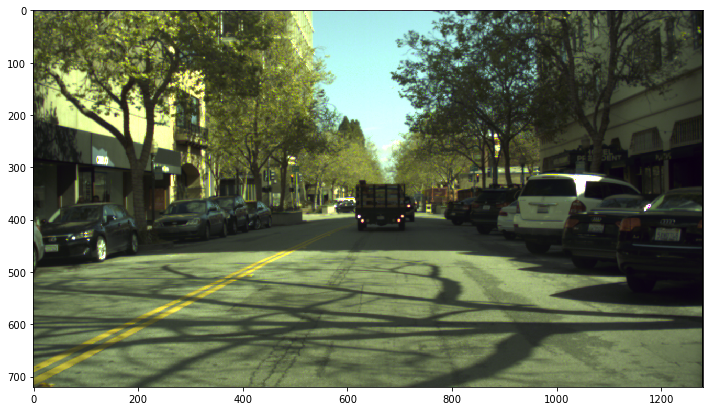

Time in ms:  119.82226371765137 



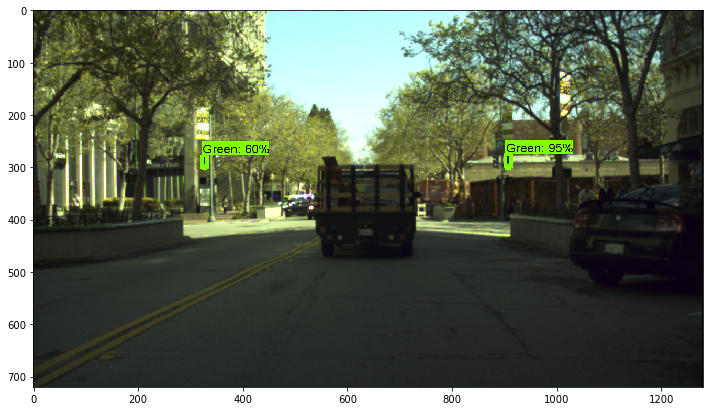

Time in ms:  119.82202529907227 



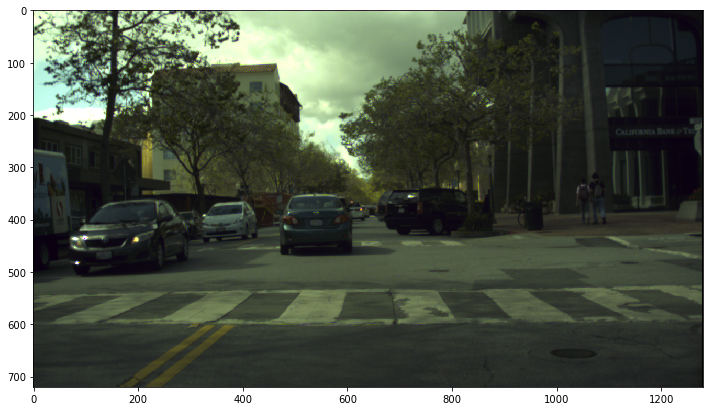

Time in ms:  119.82226371765137 



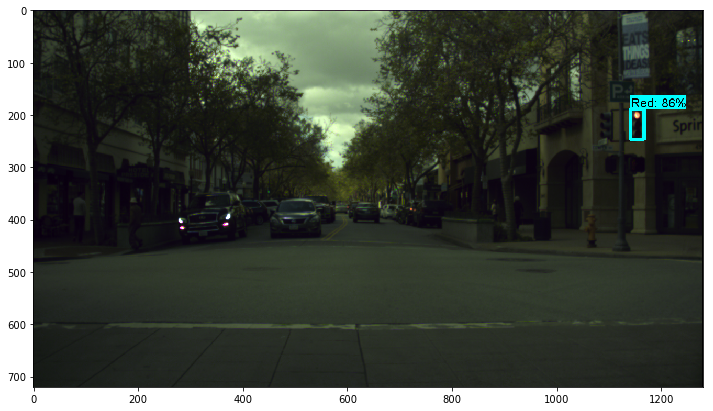

Time in ms:  120.32246589660645 



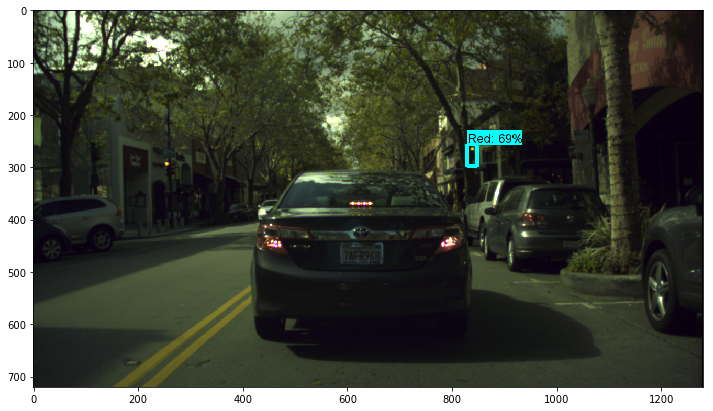

Time in ms:  120.82433700561523 



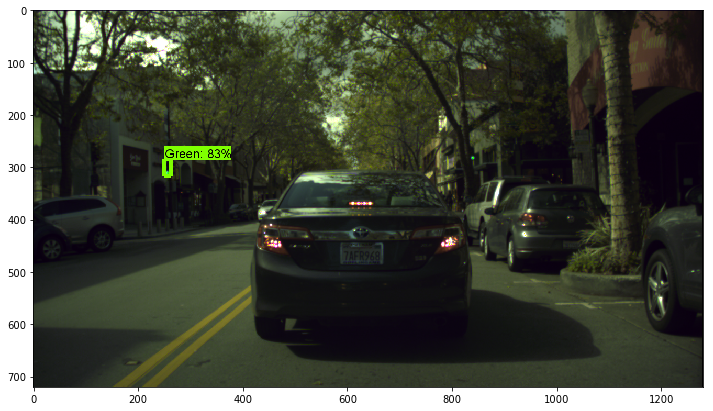

Time in ms:  122.32685089111328 



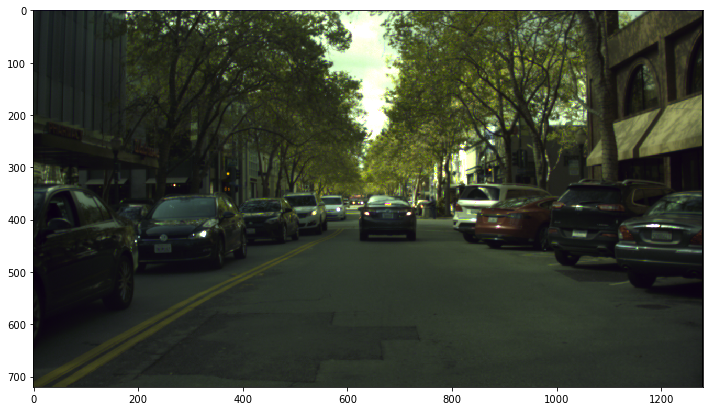

Time in ms:  121.8268871307373 



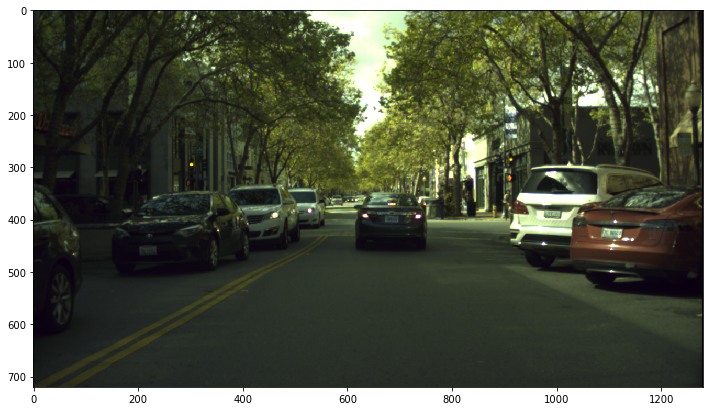

Time in ms:  118.3176040649414 



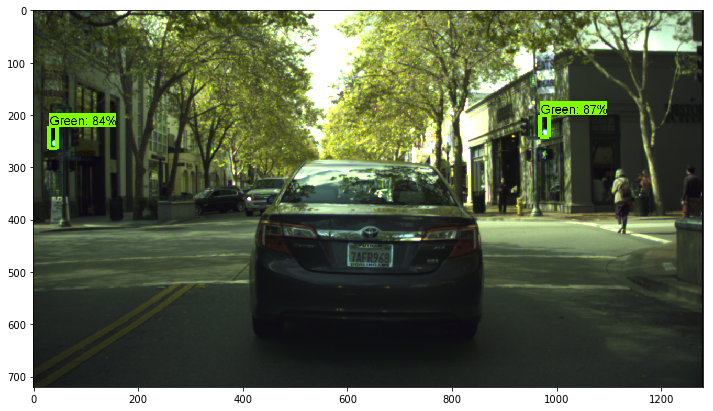

Time in ms:  121.32549285888672 



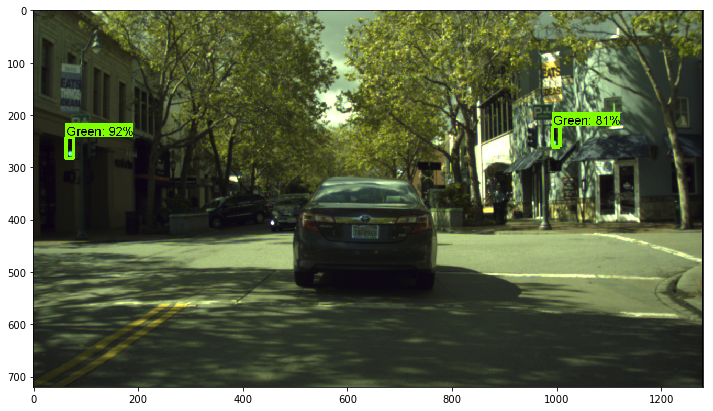

Time in ms:  120.82409858703613 



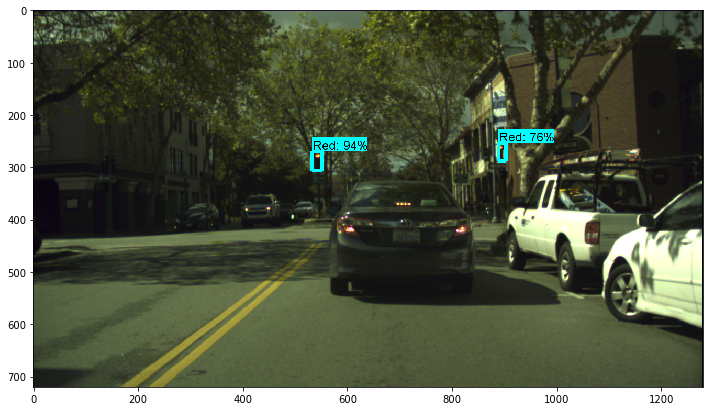

Time in ms:  121.82736396789551 



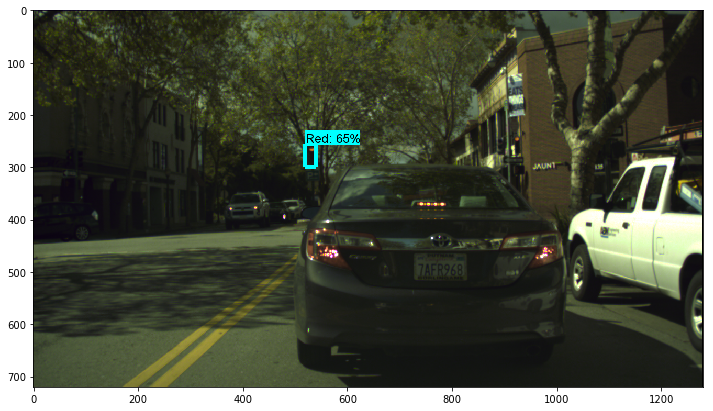

Time in ms:  121.32668495178223 



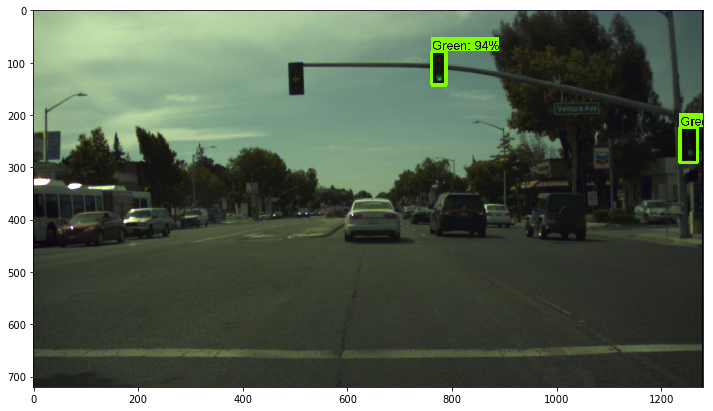

Time in ms:  119.31729316711426 



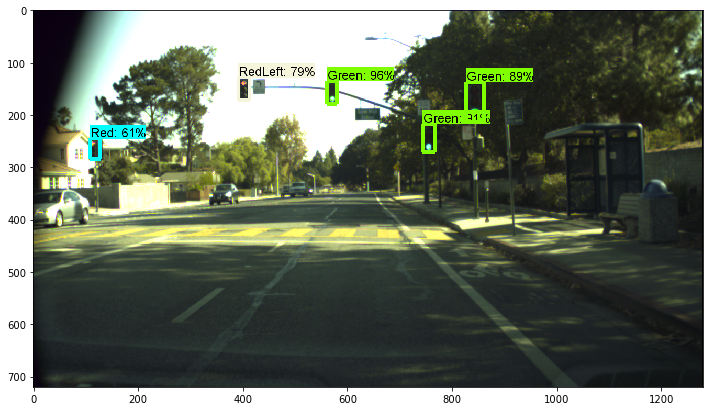

Time in ms:  120.32461166381836 



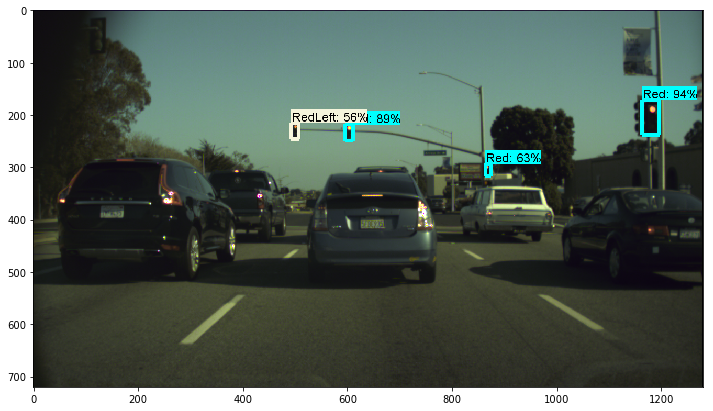

Time in ms:  120.82457542419434 



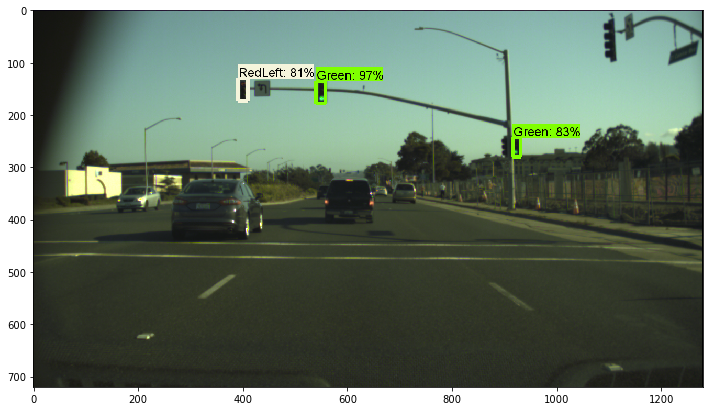

Time in ms:  119.32039260864258 



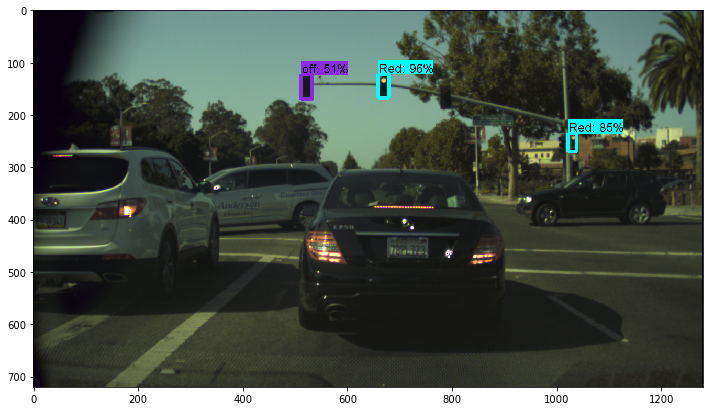

Time in ms:  120.82481384277344 



In [35]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")